In [1]:
%load_ext autoreload
%autoreload 2

In [10]:
import random
import numpy as np
import torchvision.transforms.functional as F
from torch.nn import Module
from matplotlib import pyplot as plt
from pathlib import Path
from PIL import Image
from torchvision.utils import make_grid
from timm.data import create_transform
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize

from data.transforms import Shrink, CenterCropPct


plt.rcParams["savefig.bbox"] = 'tight'

In [3]:
def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), figsize=(15, 15), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

In [9]:
512 / 585

0.8752136752136752

In [7]:
img_size = 512
create_transform(
    input_size=img_size,
    is_training=False,
    crop_pct=0.95
)

Compose(
    Resize(size=538, interpolation=bilinear, max_size=None, antialias=warn)
    CenterCrop(size=(512, 512))
    ToTensor()
    Normalize(mean=tensor([0.4850, 0.4560, 0.4060]), std=tensor([0.2290, 0.2240, 0.2250]))
)

In [48]:
image_dir = Path("/workspace/data/images_page_7/0/")
filenames = list(image_dir.glob("*.png"))

t_original = Compose(
    [
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
    ]
)
t_raw = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
    ]
)
t_shrink = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Shrink(scale=None),
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
    ]
)

In [49]:
t_original, t_raw, t_shrink

(Compose(
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
 ),
 Compose(
     CenterCropPct(size=(0.9, 0.9))
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
 ),
 Compose(
     CenterCropPct(size=(0.9, 0.9))
     ShrinkTransform(scale=None)
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
 ))

In [50]:
filenames_sample = [random.sample(filenames, 9) for _ in range(10)]

['o6qbfsgz', 'ue5isxzm', 'sgm731x6', 'sins3xy4', '3294q40o', 'mwcv47c0', 'n7jd638y', 'b2ywfagg', 'c9k5lpw4']
['1mrv16xo', 'f5q3cle3', 'en9u6hly', 'tecm42k2', '8bt9si2a', 'tk092hw9', '9vgzc181', '8haguiiw', '5iftgdeq']
['xsy0atf6', 'kjn9sa7a', 'roh79td2', '15tqrc2j', 'tmz5dqla', 'mn1uc7ly', '0k015wua', 'g8x0c6mv', 'uj49228j']
['8bt9si2a', 'nya2tghq', '3jrrivie', 't8r6hdlt', '49fwdpmu', 'tpqeppc7', 'e4f0ngw5', 'zk3kvkfe', '6235nfns']
['fa6540ir', 'dbdfsmgk', 'su4n92ve', '5ta8909l', 's4xs6gtk', '0veg0ou5', 'sgm731x6', 'gofhdiua', 'yaz5q9fh']
['tk9h5ly3', 'qdchykiv', '2sx6cuzm', 'mn7pvie8', 'jkzmfntc', 'zk3kvkfe', 'q1v2v1lh', '7gv50rwg', 'gtq0i0j5']
['qpbyhjj8', 'pgcna06j', 'zfwwjyxt', 'wakqgw49', '8sq7xxx4', 'zgl0j5pk', 'rqumqnfp', '3edao0y9', 'ohd7ppyk']
['hivilrwh', 'a0b6z7y6', '2de35vl8', 'kjn9sa7a', 'ayerxdkt', 'ok9t7sef', 'wohji03m', '53ns8snf', 'izajiqb6']
['fk6xkhhf', 'e3xwx1iz', 'slzglf95', '75ekj14o', '294mp7ao', 'dko6em1q', 'fm0elh84', 'njo4ng0d', 'neaa0gmo']
['g65our09', 'powgq

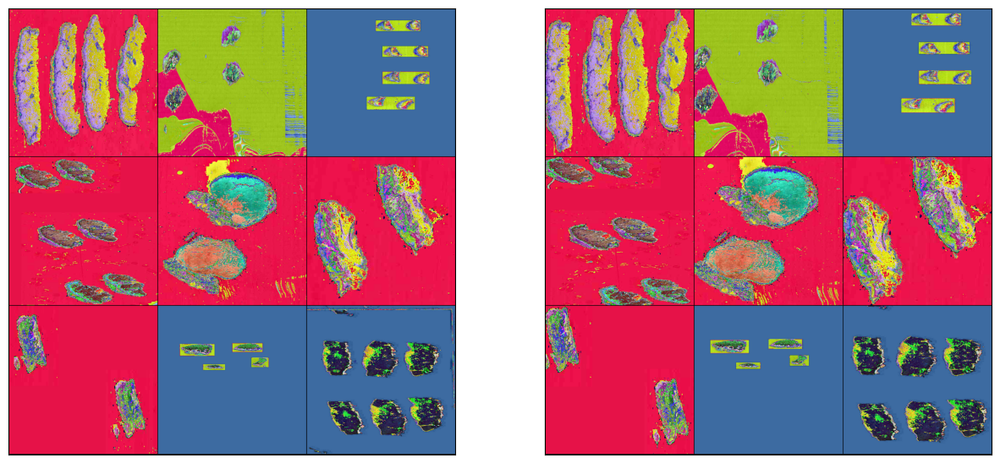

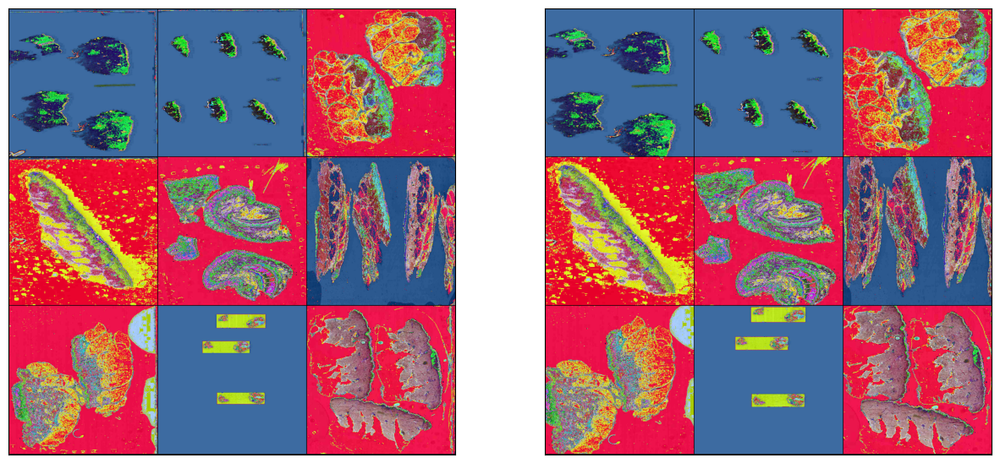

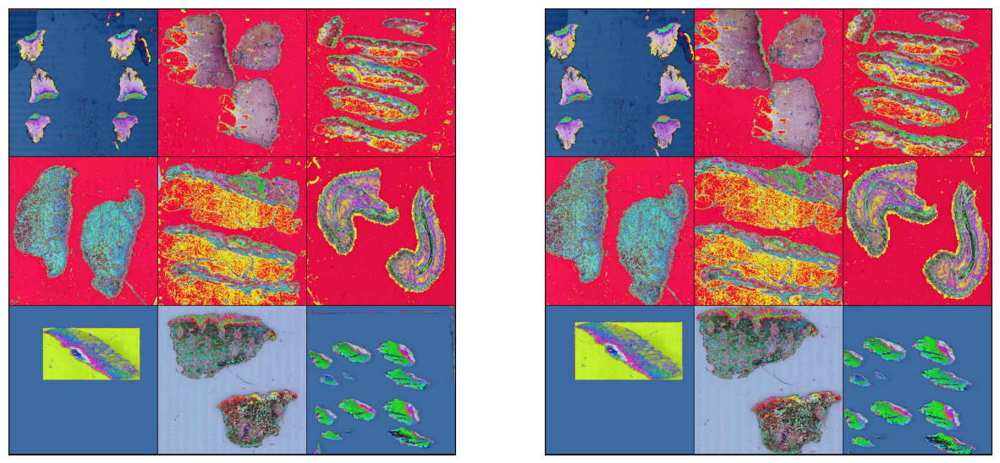

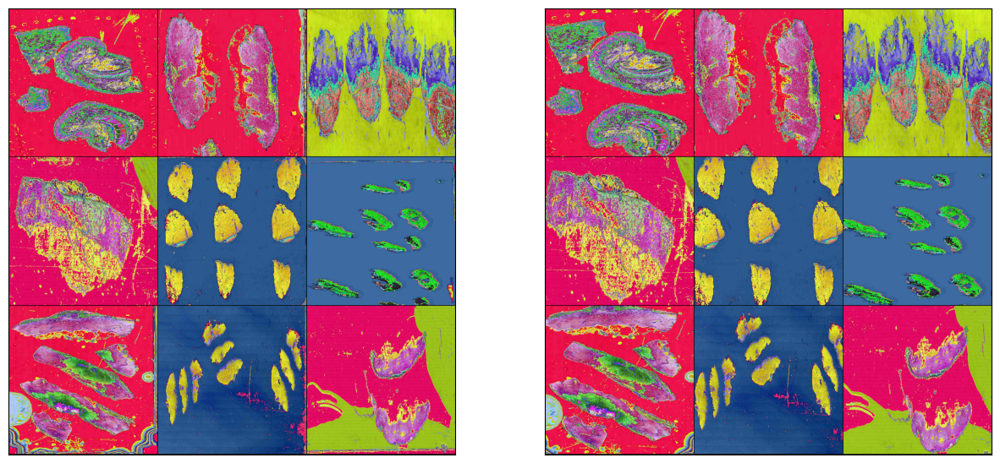

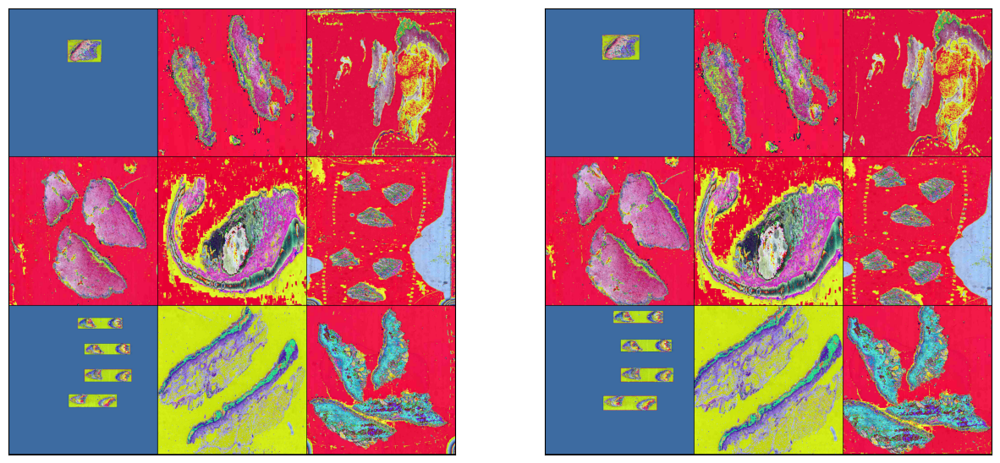

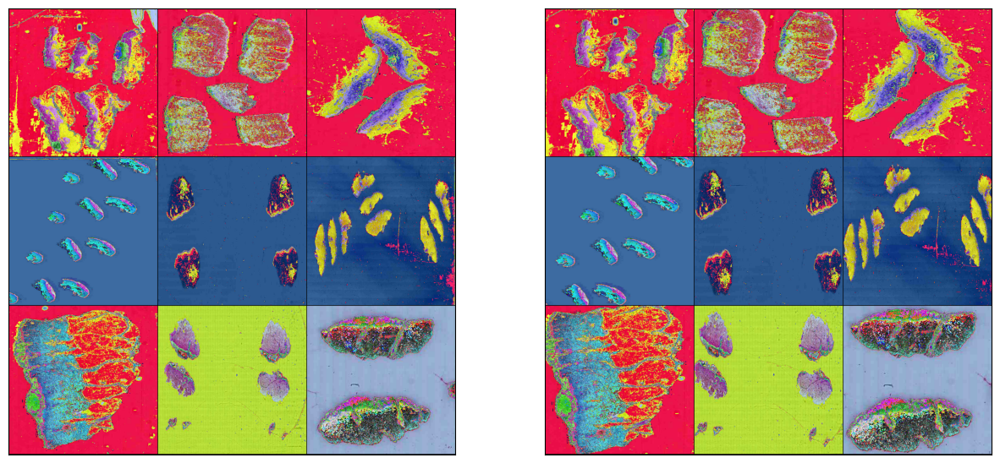

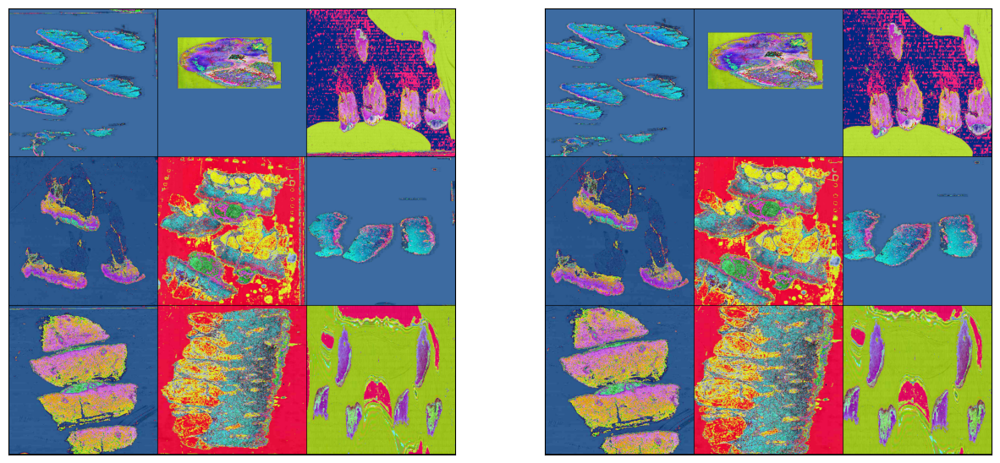

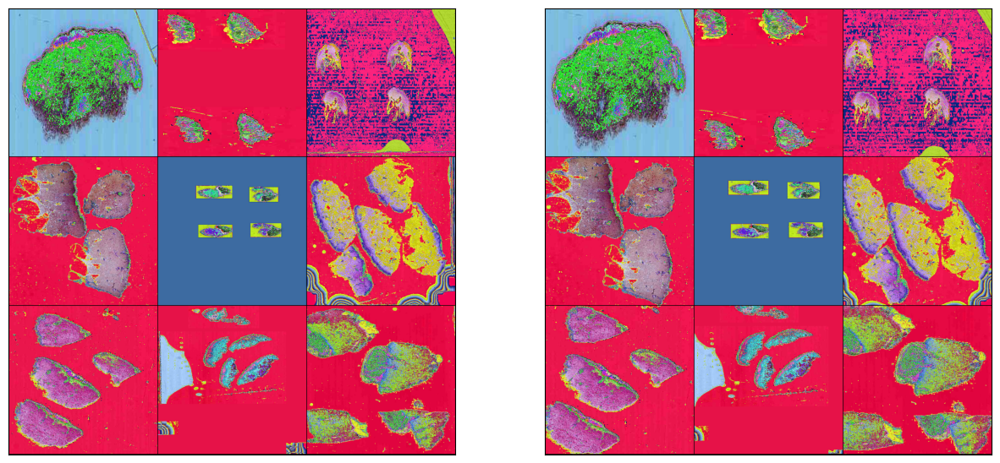

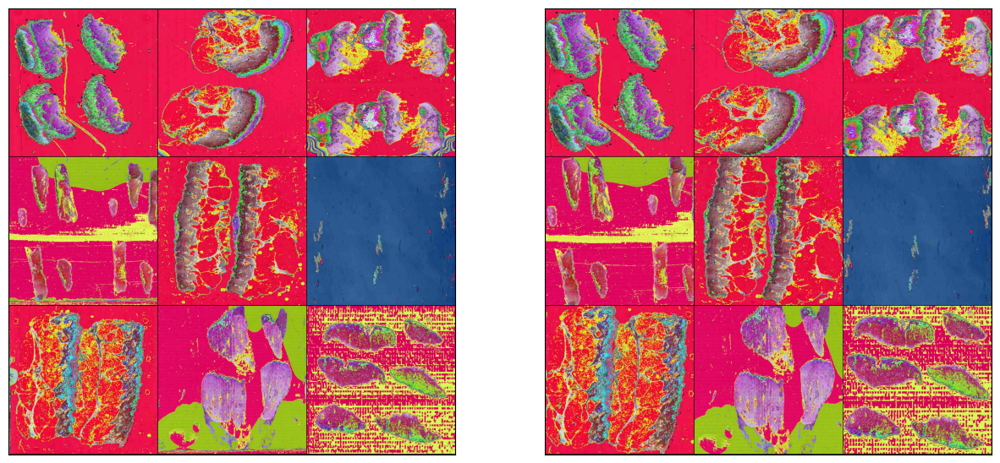

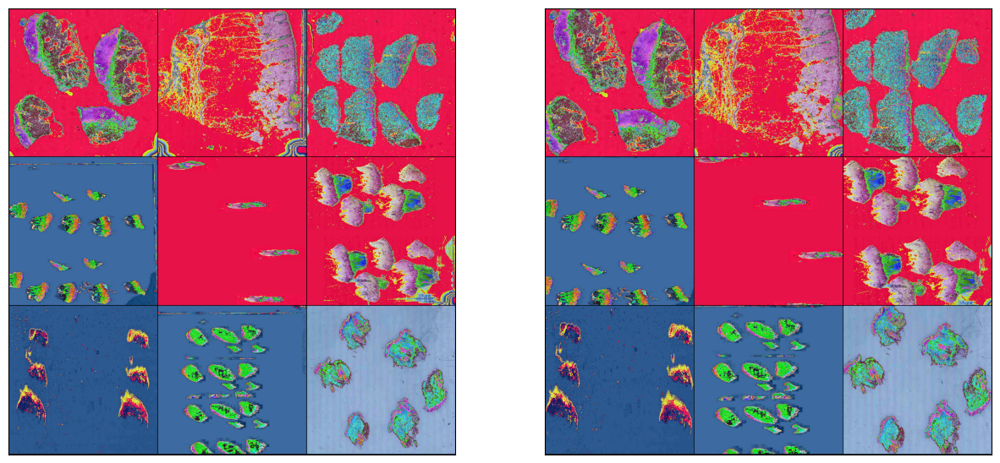

In [51]:
for sample in filenames_sample:
    images_original = [t_original(Image.open(filename)) for filename in sample]
    images_raw = [t_raw(Image.open(filename)) for filename in sample]

    grid_original = make_grid(images_original, nrow=3)
    grid_raw = make_grid(images_raw, nrow=3)

    names = [str(x.stem) for x in sample]
    print(names)
    show([grid_original, grid_raw])

['o6qbfsgz', 'ue5isxzm', 'sgm731x6', 'sins3xy4', '3294q40o', 'mwcv47c0', 'n7jd638y', 'b2ywfagg', 'c9k5lpw4']
['1mrv16xo', 'f5q3cle3', 'en9u6hly', 'tecm42k2', '8bt9si2a', 'tk092hw9', '9vgzc181', '8haguiiw', '5iftgdeq']
['xsy0atf6', 'kjn9sa7a', 'roh79td2', '15tqrc2j', 'tmz5dqla', 'mn1uc7ly', '0k015wua', 'g8x0c6mv', 'uj49228j']
['8bt9si2a', 'nya2tghq', '3jrrivie', 't8r6hdlt', '49fwdpmu', 'tpqeppc7', 'e4f0ngw5', 'zk3kvkfe', '6235nfns']
['fa6540ir', 'dbdfsmgk', 'su4n92ve', '5ta8909l', 's4xs6gtk', '0veg0ou5', 'sgm731x6', 'gofhdiua', 'yaz5q9fh']
['tk9h5ly3', 'qdchykiv', '2sx6cuzm', 'mn7pvie8', 'jkzmfntc', 'zk3kvkfe', 'q1v2v1lh', '7gv50rwg', 'gtq0i0j5']
['qpbyhjj8', 'pgcna06j', 'zfwwjyxt', 'wakqgw49', '8sq7xxx4', 'zgl0j5pk', 'rqumqnfp', '3edao0y9', 'ohd7ppyk']
['hivilrwh', 'a0b6z7y6', '2de35vl8', 'kjn9sa7a', 'ayerxdkt', 'ok9t7sef', 'wohji03m', '53ns8snf', 'izajiqb6']
['fk6xkhhf', 'e3xwx1iz', 'slzglf95', '75ekj14o', '294mp7ao', 'dko6em1q', 'fm0elh84', 'njo4ng0d', 'neaa0gmo']
['g65our09', 'powgq

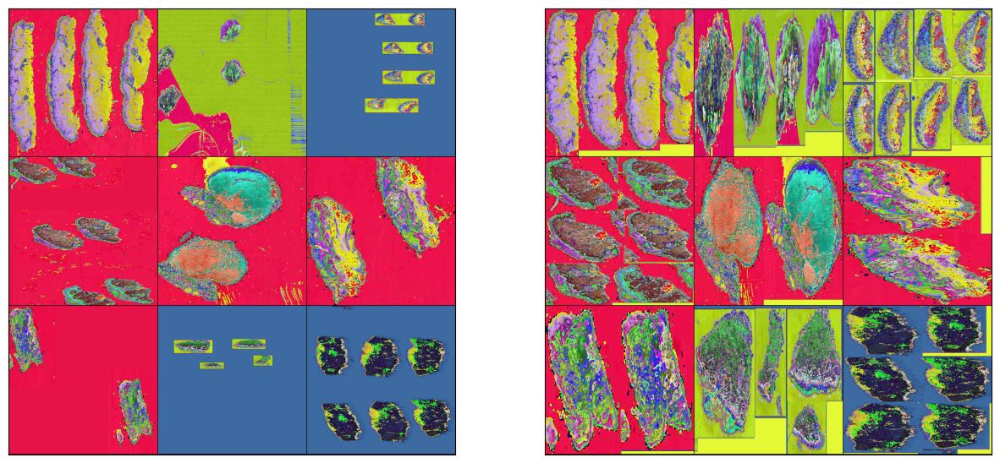

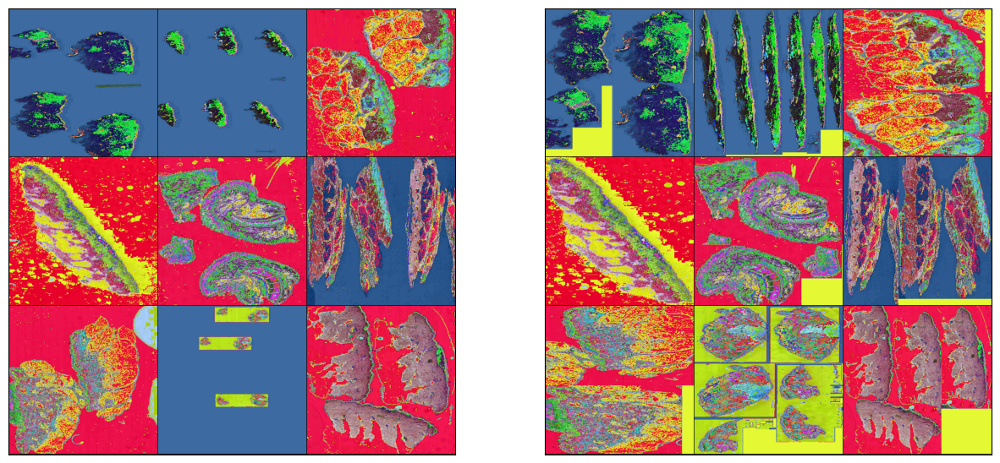

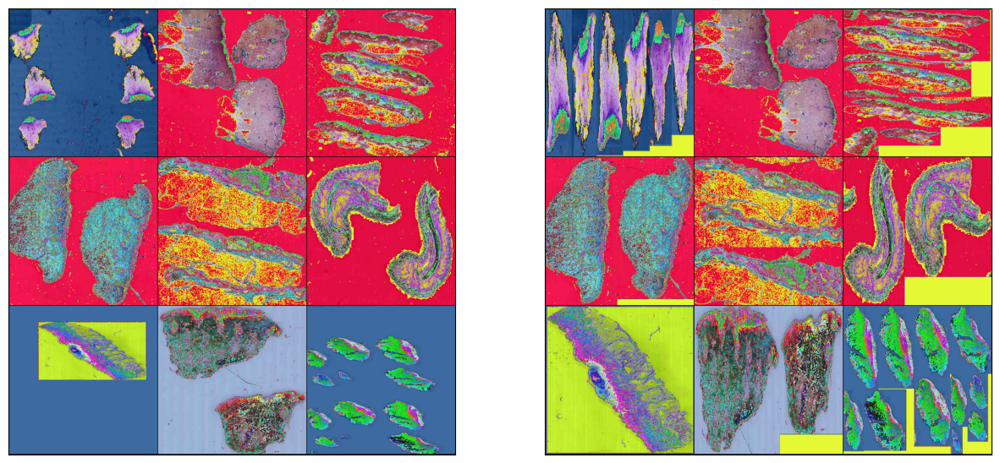

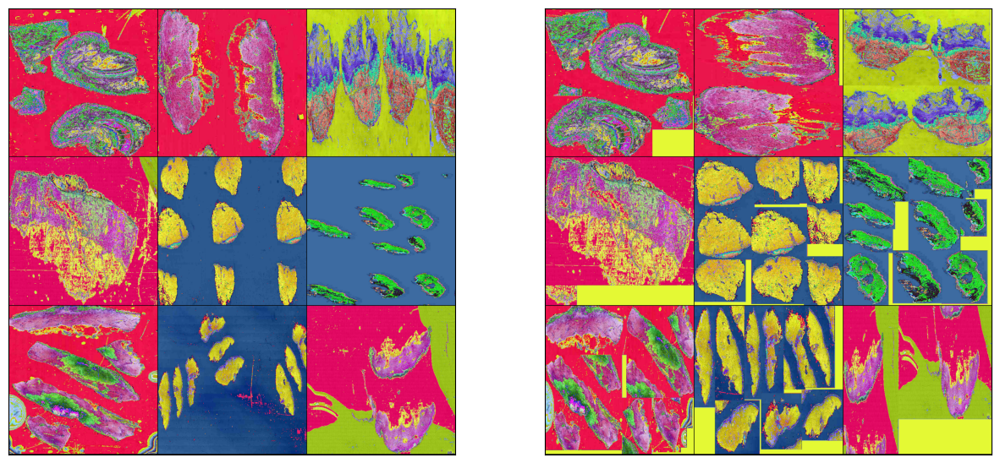

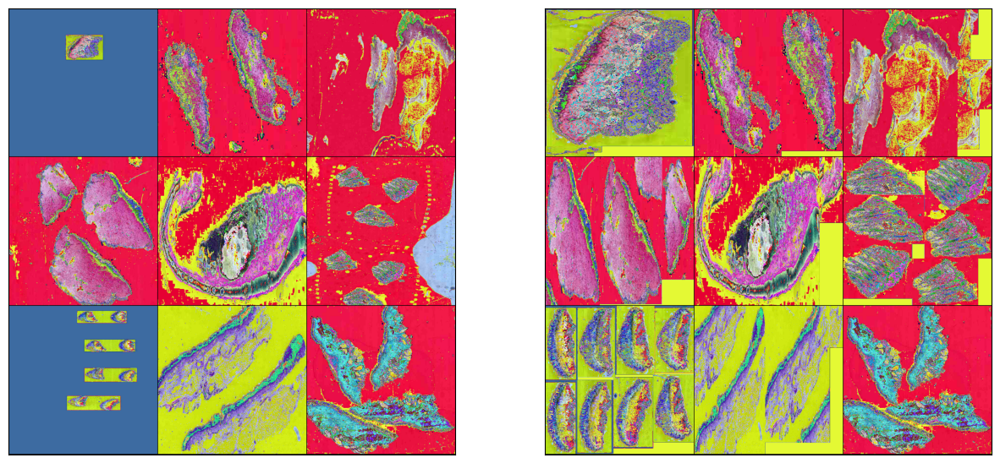

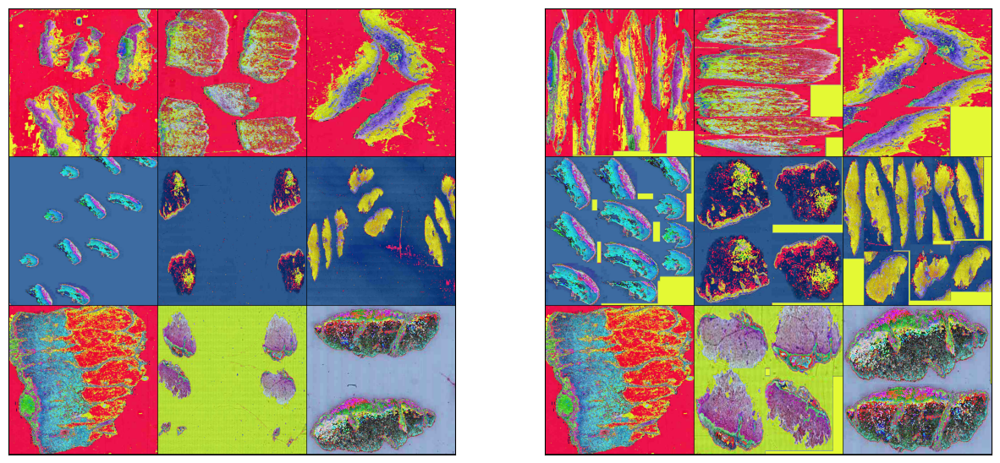

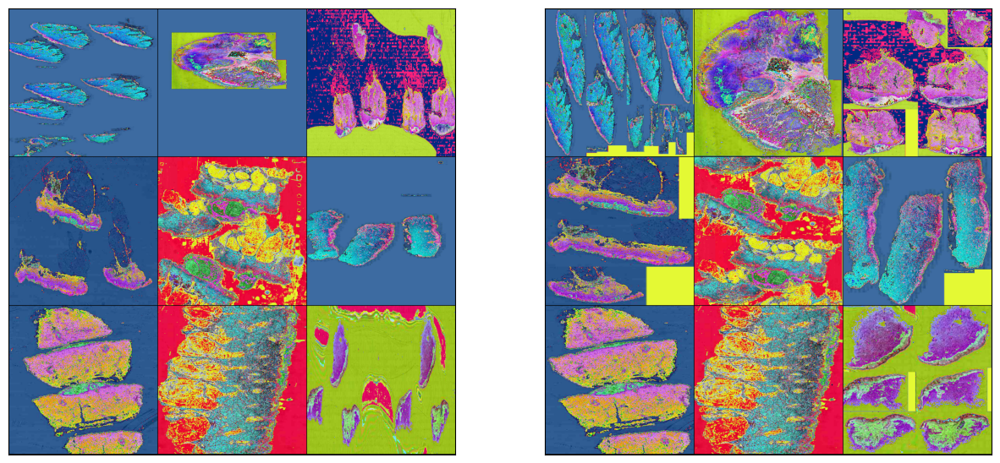

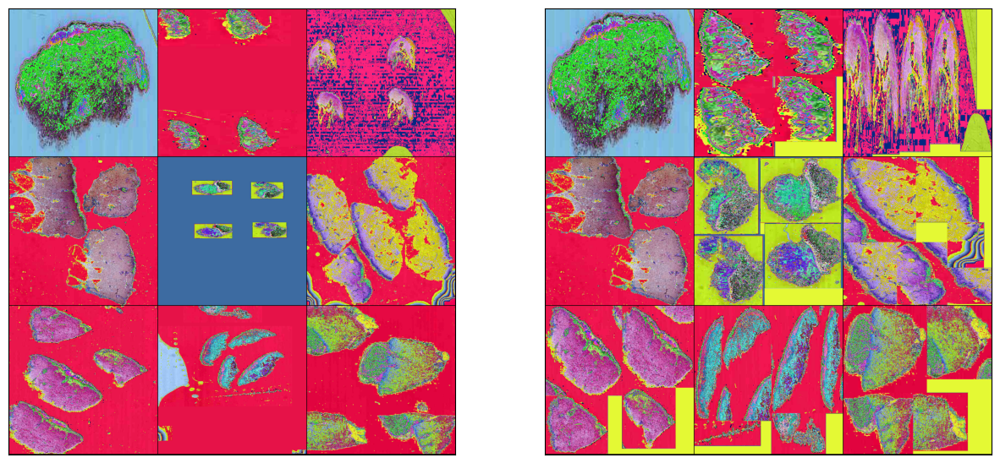

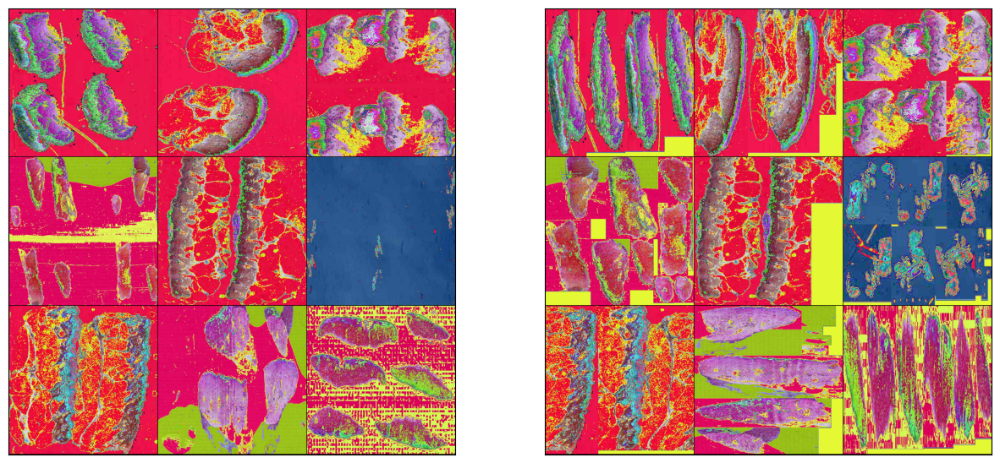

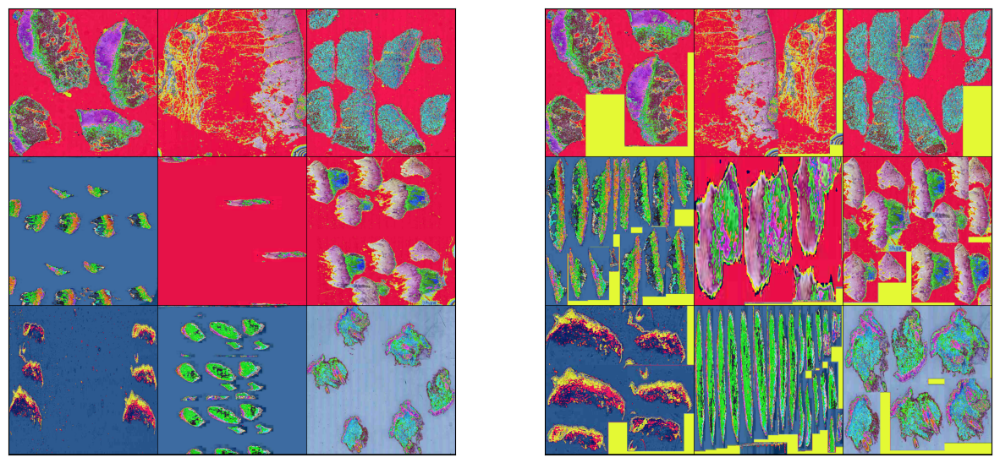

In [52]:
for sample in filenames_sample:
    images = [t_raw(Image.open(filename)) for filename in sample]
    images_shrinked = [t_shrink(Image.open(filename)) for filename in sample]

    grid = make_grid(images, nrow=3)
    grid_shrinked = make_grid(images_shrinked, nrow=3)

    names = [str(x.stem) for x in sample]
    print(names)
    show([grid, grid_shrinked])